In [1]:
#! python -m pip install ipympl geocube folium mapclassify -q
import numpy as np
import geopandas as gpd
import pandas as pd
from matplotlib import pyplot as plt
import os
import rioxarray as rio
import xarray as xr
import rasterio
import glob
from geocube.api.core import make_geocube
from shapely.errors import ShapelyDeprecationWarning
import warnings
import folium
from folium import plugins
warnings.filterwarnings("ignore", category=ShapelyDeprecationWarning) 

In [2]:
yr1_files = glob.glob('/projects/shared-buckets/gsfc_landslides/FEDSoutput-s3-conus/Thomas/2017/Largefire/*')
yr2_files = glob.glob('/projects/shared-buckets/gsfc_landslides/FEDSoutput-s3-conus/Thomas/2018/Largefire/*')
lf_files = yr1_files + yr2_files
lf_ids = list(set([file.split('Largefire/')[1].split('_')[0] for file in lf_files])) # unique lf ids
print('Number of LF ids:',len(lf_ids))

Number of LF ids: 1


In [3]:
last_ob = lf_files[-1]

In [12]:
basins = gpd.read_file('/projects/my-public-bucket/thomas_fire_barc/thm2017_Basin_DFPredictions_15min_12mmh.shp')
df = gpd.read_file('/projects/my-public-bucket/thomas_fire_barc/Montecito_Inundation_poly.shp')
mont = gpd.read_file('/projects/my-public-bucket/thomas_fire_barc/montecito_outline.geojson')

df.to_crs('ESRI:102039',inplace=True)
basins.to_crs('ESRI:102039',inplace=True)
mont.to_crs('ESRI:102039',inplace=True)

In [14]:
in_bounds = gpd.overlay(basins,mont,'intersection')
in_bounds.set_index('BASIN_ID',inplace=True)
basins.set_index('BASIN_ID',inplace=True)
basins = basins.loc[in_bounds.index]
basins.reset_index(inplace=True)

In [15]:
df['FlowIndex'] = df.index

In [16]:
# basins.rename(columns={'L_X1':'PropHM23',
#                        'L_X2':'Mean_dNBR',
#                        'L_X3':'Mean_KF'},inplace=True)
# df.rename(columns={'Shape_Area':'FlowArea',
#                    'Id':'FlowID'},inplace=True)

In [4]:
layer = 'perimeter' # options are: fireline, newfirepix, perimeter, or nfplist
gdf = gpd.read_file(last_ob,layer=layer)
gdf.sort_values('t',ascending=False,inplace=True)
keep = gdf['geometry'].drop_duplicates(keep='last')
pixels = gpd.read_file(last_ob,layer='nfplist')
m = gdf.drop('t',axis=1).explore(column='meanFRP',
                cmap='jet',
                style_kwds={'fillOpacity':0})
#pixels.explore(m=m,
#               column='frp', #vmax=100,
#               cmap='YlOrRd',
#               style_kwds={'fillOpacity':1})
folium.LayerControl().add_to(m)
m

In [5]:
# m = basins[['PropHM23', 'Mean_dNBR', 'Mean_KF','geometry']].explore(column='PropHM23',
#                                                     cmap='YlOrRd',
#                                                     tiles='Stamen Terrain',
#                                                     name='USGS Basins')
# pixels.drop(['t','datetime'],axis=1).explore(m=m,
#                column='frp', #vmax=100,
#                cmap='YlOrRd',
#                style_kwds={'fillOpacity':1},
#                name='Pixels')
# gdf.drop('t',axis=1).explore(m=m,
#             column='meanFRP',
#             cmap='RdBu_r',vmax=50,tiles='stamen terrain',
#             name='Perimeters')

# df.explore(m=m,name='DF Perimeters')
# folium.LayerControl().add_to(m)
# m

NameError: name 'basins' is not defined

In [6]:
def classify_ampm(row):
    t = row['t']
    if '12:00:00' in t:
        row['ampm'] = 'PM'
    else:
        row['ampm'] = 'AM'
    return row

In [8]:
# barc = rio.open_rasterio('/projects/my-public-bucket/thomas_fire_barc/thomas_soil_burn_severity.tif')
# mtbs = rio.open_rasterio('/projects/shared-buckets/gsfc_landslides/mtbs/mtbs_CONUS_2017.tif',variable='band')
# evt = rio.open_rasterio('/projects/shared-buckets/gsfc_landslides/LANDFIRE/LF2016_EVT_200_CONUS/Tif/LC16_EVT_200.tif')

In [11]:
gdf.to_crs('ESRI:102039',inplace=True)
pixels.to_crs('ESRI:102039',inplace=True)

In [9]:
mtbs_perimeters = gpd.read_file('/projects/shared-buckets/gsfc_landslides/mtbs/mtbs_perims_DD.shp')
mtbs_perimeters.to_crs('ESRI:102039',inplace=True)
mtbs_perimeters['Ig_Date'] = pd.to_datetime(mtbs_perimeters['Ig_Date'])

In [10]:
yr = '2015' #fires_path.split('.gpkg')[0][-4:] # ugly 1 line yr parse

In [11]:
start = pd.to_datetime(yr+'-01-01')
end = pd.to_datetime(yr+'-12-31')

In [12]:
xmin, ymin, xmax, ymax = perimeters.total_bounds

In [13]:
mtbs_subset = mtbs_perimeters[(mtbs_perimeters['Ig_Date']>start)&
                             (mtbs_perimeters['Ig_Date']<end)]
mtbs_subset = mtbs_subset.cx[xmin:xmax,ymin:ymax]
print(mtbs_subset.shape)

(290, 23)


In [14]:
p = perimeters.sort_values(['ID','t'])

In [15]:
p = p.loc[p['ID'].drop_duplicates(keep='last').index]

In [17]:
p.shape

(342, 11)

In [18]:
m = mtbs_subset.geometry.explore(color='blue',name='MTBS')
p.geometry.explore(m=m,color='black',name='Largefire')
folium.LayerControl().add_to(m)
m

In [16]:
mtbs_paths = glob.glob("/projects/shared-buckets/gsfc_landslides/mtbs/*.tif")
#_ = [print(path) for path in mtbs_paths]

In [17]:
# load in mtbs data for that year - this is a single band, CONUS scale raster
mtbs_path = [path for path in mtbs_paths if yr in path][0]
mtbs = rio.open_rasterio(mtbs_path,variable='band')
mtbs = mtbs.squeeze().drop('band')
    
# load in evt data & metadata, using the dict from earlier
evt = rio.open_rasterio(lf_dict[yr]['evt_path']) 
evt_metadata = pd.read_csv(lf_dict[yr]['metadata_path'],index_col='VALUE')
evt_metadata.drop(-9999,inplace=True) # -9999 is the nodata value

In [18]:
def format_pixel_dates(row):
    date = row.datetime.split('T')[0]
    period = row.ampm
    if period=='AM':
        date = date+'T00:00:00'
    else:
        date = date+'T12:00:00'
    
    return date

def perimeter_union(fire):
    times = fire.index.unique()
    #print(times)
    fire['t'] = fire.index
    poly_list = []
    for i in range(len(times)-1): # -1 because we're looking 1 timestep ahead at each time t
        j = i + 1
        
        if i==0: # make sure to include first observation
            base_perimeter = fire.loc[times[i]:times[i]][['t','geometry']].copy()
            poly_list.append(base_perimeter)
        
        f1 = fire.loc[times[i]:times[i]] # times[i]:times[i] returns dataframe (we want that)
        f2 = fire.loc[times[j]:times[j]] # next timestep
        diff = f2.overlay(f1, how='difference') # take difference
        
        ex = diff.explode(ignore_index=True) # convert single multipolygon geo to many polygons
        ex_polys = ex[['t','geometry']].copy() # only need these cols
        poly_list.append(ex_polys)
    return pd.concat(poly_list,ignore_index=True) 

def add_ampm(row):
    hr = row['t'].split('T')[1]
    if hr=='00:00:00':
        row['isPM'] = 0
    else:
        row['isPM'] = 1
    return row

In [12]:
#m = perimeters.explore(column='meanFRP',tiles='Stamen Terrain',
#             style_kwds={'fillOpacity':0})
#mtbs_subset.drop('Ig_Date',axis=1).explore(m=m)
#folium.LayerControl().add_to(m)
#m

In [21]:
perimeters.columns

Index(['n_pixels', 'n_newpixels', 'farea', 'fperim', 'flinelen', 'duration',
       'pixden', 'meanFRP', 't', 'geometry', 'ID'],
      dtype='object')

In [28]:
max_areas = perimeters.groupby('ID')['farea'].max().sort_values(ascending=False)

In [73]:
i = 2
# KNP_Complex, WINDY
ID = max_areas.index[i]
fire = perimeters[perimeters['ID']==ID].copy()
fire.sort_values('t',ascending=True,inplace=True)
fire_pix  = pixels[pixels['ID']==ID].copy()
fire['fid'] = fire.index

In [74]:
fire.set_index('t',inplace=True)
fire_pix.set_index('t',inplace=True)

In [75]:
union = perimeter_union(fire)
union['id'] = union.index
union.sort_values('t',ascending=False,inplace=True)

fire_pix['geometry'] = fire_pix.geometry.buffer(50)
join_p = union.sjoin(fire_pix)
join_p['pixel_interval'] = pd.to_datetime(join_p['index_right'])
    
# frp summary stats
grp = join_p.groupby(join_p['id']).agg(['max','median','mean','count'])['frp']

# num of unique pixel intervals observed (e.g., [2021-01-01 AM, 2021-01-01 PM] = 2)
grp_nunique = join_p.groupby(join_p['id'])['pixel_interval'].nunique()

# total time between first and last observation for that region
grp_range = join_p.groupby(join_p['id'])['pixel_interval'].agg(['min','max'])
grp_range['range'] = grp_range['max'] - grp_range['min']

# add these values to the other groupby op
grp['unique_periods'] = grp_nunique

for col in grp_range.columns:
    
    if col=='range':
        grp['date_'+col] = grp_range['range'] # timedelta object
        continue
    
    # convert dates back to string
    grp['date_'+col] = grp_range[col].apply(lambda x: x.strftime('%Y-%m-%dT%H:%M:%S'))

result = pd.merge(union, grp, left_on='id',right_index=True,how='outer')
result.rename(columns={'max':'frp_max',
                       'median':'frp_median',
                       'mean':'frp_mean',
                       'count':'pixel_count'},inplace=True)
result.dropna(inplace=True)
result = result.apply(add_ampm,axis=1) # add PM flag
result['fid'] = fire['fid'].unique()[0]
#result['Name'] = fire['Name'].unique()[0]
result['date_range_h'] = result['date_range']/ np.timedelta64(1, 'h')
result['area'] = result.geometry.area / 1000000

In [76]:
print(len(result['id'].unique()) == len(result['id']) == len(result['geometry'].unique()))
m = result.drop('date_range',axis=1).explore(column='frp_mean',
                                             cmap='YlOrRd',
                                        tiles='Stamen Terrain',
                                        style_kwds={'fillOpacity':0.1})
#fire_pix.explore(m=m,vmax=300,column='frp',cmap='YlOrRd')
folium.LayerControl().add_to(m)
m

True


In [ ]:
# i = 1
# times = result['t'].unique()
# times.sort()
# m = result[(result['t']==times[i])|(result['t']==times[i+1])].drop('date_range',axis=1).explore(column='frp_mean',
#                                         tiles='Stamen Terrain',
#                                         style_kwds={'fillOpacity':0.1})
# #fire_pix.explore(m=m,vmax=300,column='frp',cmap='YlOrRd')
# folium.LayerControl().add_to(m)
# m

In [101]:
bounds = fire.geometry.total_bounds # final perimeter geo
minx = bounds[0]
miny = bounds[1]
maxx = bounds[2]
maxy = bounds[3]

In [102]:
bs = mtbs.sel(x=slice(minx,maxx),
              y=slice(maxy,miny))
bs_mask = (bs < 5) & (bs != 0)
bs = bs.where(bs_mask)

In [103]:
#g = result.iloc[2].geometry.__geo_interface__
#print((g))

In [104]:
#bs.rio.clip(g)

In [105]:
lf_subset = evt.sel(x=slice(minx,maxx),
                    y=slice(maxy,miny)).squeeze()

lf_subset_matched = lf_subset.rio.reproject_match(bs,resampling=1).where(bs_mask)
lf_subset_matched.assign_coords({"x": bs.x,
                                 "y": bs.y})

bs_f = bs.values.flatten()
lf_f = lf_subset_matched.values.flatten()

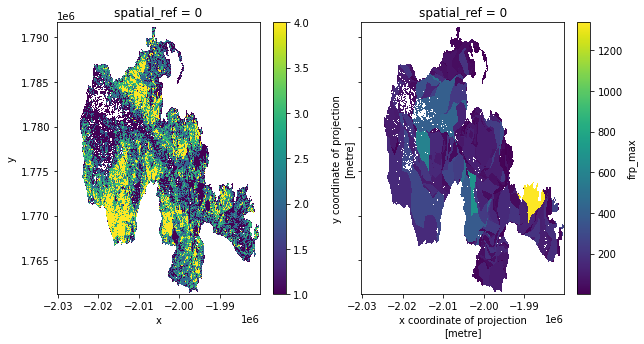

In [106]:
cube = make_geocube(result,measurements=['id','frp_max','frp_mean','frp_median',
                                         'pixel_count','area','isPM',
                                         'date_range_h','unique_periods'],
                        like=bs,fill=np.nan).where(bs_mask)
fig, ax = plt.subplots(1,2,figsize=(10,5),sharex=True,sharey=True)
bs.plot(ax=ax[0])
cube['frp_max'].plot(ax=ax[1])
cube_df = cube.to_dataframe()
cube_df.reset_index(inplace=True)

In [107]:
# add burn severity band to rasterized perimeter data
cube['bs'] = (bs.dims, bs.values, bs.attrs, bs.encoding)
cube['lf'] = (lf_subset_matched.dims, lf_subset_matched.values, lf_subset_matched.attrs, lf_subset_matched.encoding)

In [108]:
df = cube.to_dataframe()
df.reset_index(inplace=True)

In [109]:
#grp = df.groupby('id')['lf'].agg(pd.Series.mode)
lf_mode= df.groupby('id')['lf'].agg(lambda x: x.value_counts().index[0])
bs_mean = df.groupby('id')['bs'].mean().round().rename('bs_mean') # need to round to return to class vals
bs_median = df.groupby('id')['bs'].median().round().rename('bs_median')
all_stats = pd.concat([lf_mode,bs_mean,bs_median],axis=1,join='inner')

In [110]:
result = result.merge(all_stats,on='id')

<AxesSubplot:>

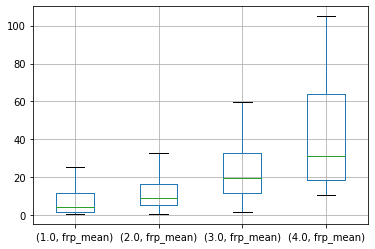

In [112]:
result.groupby(['bs_mean']).boxplot(column='frp_mean',
                                    subplots=False,
                                    showfliers=False)

In [ ]:
# compute zonal stats!
# from https://corteva.github.io/geocube/html/examples/zonal_statistics.html
grp = cube.drop("spatial_ref").groupby(cube['id']) # id == unique perimeter segment
grid_mean = grp.mean()['bs'].rename('bs_mean').round() # mean bs values for each segment
grid_median = grp.median()['bs'].rename('bs_median').round() # same but median
#grid_max = grouped_elevation.max().rename({"elevation": "elevation_max"})
#grid_std = grouped_elevation.std().rename({"elevation": "elevation_std"})

In [ ]:
import scipy
def _mode(*args, **kwargs):
    vals = scipy.stats.mode(*args, **kwargs)
    # only return the mode (discard the count)
    return vals[0].squeeze()

In [ ]:
cube

In [ ]:
zonal_stats = xr.merge([grid_mean, grid_median]).to_dataframe()
zonal_stats.drop('spatial_ref',axis=1,inplace=True)
zonal_stats

In [ ]:
result = result.merge(zonal_stats, on="id") # add back to perimeter gdf

In [ ]:
result.groupby('bs_median').median()['frp_max']

In [ ]:
result.groupby('bs_median').boxplot(column='frp_mean',subplots=False,showfliers=False)

In [ ]:
result.shape

In [ ]:
data = pd.DataFrame(zip(bs_f,
                        lf_f),
                        columns=['MTBS_VAL','EVT_VAL'])
for col in cube_df.columns:
        data[col] = cube_df[col]

In [ ]:
data.dropna(inplace=True) 
print(data.shape)

cols = ['EVT_SBCLS', 'EVT_PHYS', 'EVT_LF', # cols in metadata
            'EVT_ORDER', 'EVT_CLASS'] 

# apply all related metadata to each pixel based on it's LF-EVT val
for col in cols:
    print(col)
    data[col] = data['EVT_VAL'].apply(lambda x: evt_metadata.loc[x,col])

In [ ]:
data.groupby('MTBS_VAL')['frp_max'].median()

In [ ]:
data.groupby('MTBS_VAL').boxplot(column='date_range_h',
                                 subplots=False,
                                 showfliers=False)

In [ ]:
col = 'EVT_LF'
evt_count = data.groupby([col],dropna=True).count()['EVT_VAL'] / len(data)
evt_most_common = evt_count.sort_values(ascending=False).index[:3].tolist()

mtbs_count = data.groupby([col,'MTBS_VAL'],dropna=True).count()['EVT_VAL'] / len(data)
mtbs_count_most_common = mtbs_count.loc[evt_most_common]


fig, ax = plt.subplots(1,2,figsize=(10,5))
evt_count.loc[evt_most_common].plot(ax=ax[0],kind='bar',rot=25)
mtbs_count_most_common.plot(ax=ax[1],kind='barh')
ax[1].set_title('MTBS VALUE')
ax[1].set_xlim(0,0.5)

fig.tight_layout()

In [ ]:
viz_cols = ['frp_mean','area','frp_max'] 
evt_col = 'EVT_PHYS'
evt_df = data.copy().set_index([evt_col,'MTBS_VAL'])
# sort by veg type, then burn severity

evt_count = data.groupby([evt_col],dropna=True).count()['EVT_VAL'] / len(data)
evt_most_common = evt_count.sort_values(ascending=False).index[:3].tolist()

for evt_type in evt_most_common:
    fig, ax = plt.subplots(1,len(viz_cols),figsize=(12,3))
    evt_ = evt_df.loc[evt_type]
    i = 0
    for viz_col in viz_cols: # each col is visualized by mtbs val
        for val in evt_.index.unique(): # loop for each mtbs vals
            
            # evt = veg type, val = mtbs val, viz_col = fire feature
            df_veg_mtbs = evt_.loc[val][viz_col]
            ax[i].boxplot(df_veg_mtbs, # plot that mtbs val 
                          labels=[str(val)+'\n'+'n='+str(len(df_veg_mtbs))],
                          positions=[val],showfliers=False)
            ax[i].set_title(evt_type + ' (n='+str(len(evt_))+')')
            ax[i].set_xlabel('MTBS VALUE')
            ax[i].set_ylabel(viz_col)
        i+=1
    fig.tight_layout()